In [1]:
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from typing import List, Tuple, Union, Dict

In [2]:
y = np.array([-1, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000])
x = np.array([[0,1,2,3,4], [5,6,7,8,9]])
y[x]

array([[ -1, 100, 200, 300, 400],
       [500, 600, 700, 800, 900]])

In [ ]:
def calculate_histogram(img: np.ndarray) -> np.ndarray:
    """
    Calculate the histogram of a given image.

    Args:
    - img (np.ndarray): The input image.

    Returns:
    - np.ndarray: The histogram of the input image.
    """

    hist = np.zeros(256)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            hist[img[i, j]] += 1
    return hist

def calculate_cumulative_histogram(hist: np.ndarray) -> np.ndarray:
    """
    Calculate the cumulative histogram of a given histogram.

    Args:
    - hist (np.ndarray): The input histogram.

    Returns:
    - np.ndarray: The cumulative histogram.
    """

    cum_hist = np.zeros(256, dtype=np.float64)
    for i in range(256):
        sum_so_far = 0
        for j in range(i+1):
            sum_so_far += hist[j]
        cum_hist[i] = sum_so_far
        # cum_hist[i] = np.sum(hist[:i+1])
    # cum_hist = np.cumsum(hist, dtype=float)
    return cum_hist

def get_color_at_percentage(cum_hist: np.ndarray, percentage: float) -> Tuple[int, int]:
    """
    Get the intensities that cover the given percentage of the image.

    Args:
    - cum_hist (np.ndarray): The cumulative histogram of the image.
    - percentage (float): The percentage of the image to cover.

    Returns:
    - Tuple[int, int]: The intensities that cover the given percentage of the image.
    """
    assert percentage >= 0 and percentage <= 100, "Percentage should be between 0 and 100."
    min_intensity_at_percentage = None
    cum_hist_percent = (cum_hist / cum_hist[-1]) * 100

    for i in range(256):
        curr_percent = cum_hist_percent[i]
        if curr_percent >= percentage:
            min_intensity_at_percentage = i
            break

    max_intensity_at_percentage = None
    for i in range(256):
        curr_percent = cum_hist_percent[i]
        if curr_percent >= 100-percentage:
            max_intensity_at_percentage = i
            break

    return min_intensity_at_percentage, max_intensity_at_percentage

def get_colors_at_max_slope(cum_hist: np.ndarray) -> Tuple[int, int]:
    """
    Get the intensities that have the maximum slope-like score.

    Args:
    - cum_hist (np.ndarray): The cumulative histogram of the image.

    Returns:
    - Tuple[int, int]: The intensities that have the maximum slope-like score.
    """

    max_slope_like_score = float('-inf')
    intensities = (-1,-1)
    for i in range(256):
        for j in range(i+1, 256):
            slope_like_score = (cum_hist[j] - cum_hist[i])**4 / (j - i)
            if slope_like_score > max_slope_like_score:
                max_slope_like_score = slope_like_score
                intensities = (i, j)
    return intensities

# I made it in case np.clip is unallowed but did not use it yet
def clip(img: np.ndarray, a: int, b: int) -> np.ndarray:
    """
    Clip the image to the range [a, b].

    Args:
    - img: The input image.
    - a: The lower bound of the range.
    - b: The upper bound of the range.

    Returns:
    - np.ndarray: The clipped image.
    """
    new_img = np.zeros_like(img, dtype=img.dtype)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            new_img[i, j] = max(a, min(img[i, j], b))
    return new_img


def stretch_contrast(img: np.ndarray, a: int, b: int, c: int, d: int) -> np.ndarray:
    """
    Stretch the contrast of the image in range [c,d] to the range [a, b].

    Args:
    - img: The input image.
    - a: The lower bound of the output range.
    - b: The upper bound of the output range.
    - c: The lower bound of the input range.
    - d: The upper bound of the input range.

    Returns:
    - np.ndarray: The contrast stretched image
    """

    scale_factor = (b-a)/(d-c)
    img_float = np.array(img, dtype=np.float64)
    new_img = (img_float - c) * scale_factor + a
    # new_img = np.round(new_img)
    # new_img = np.zeros_like(img, dtype=np.float64)
    # for i in range(img.shape[0]):
    #     for j in range(img.shape[1]):
    #         new_img[i, j] = np.round((img[i, j] - c) * scale_factor) + a
    new_img = np.clip(new_img, a, b)
    return np.array(new_img, dtype=np.uint8)

# I made it in case equalized_intensities[img] is unallowed but did not use it yet
def assign_equalized_intensities(img: np.ndarray, equalized_intensities: np.ndarray) -> np.ndarray:
    """
    Assign the equalized intensities to the image.

    Args:
    - img: The input image.
    - equalized_intensities: The equalized intensities.

    Returns:
    - np.ndarray: The image with equalized intensities.
    """
    equalized_img = np.zeros_like(img, dtype=img.dtype)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            equalized_img[i, j] = equalized_intensities[img[i, j]]
    return equalized_img

def equalize_histogram(img: np.ndarray, a: int, b: int) -> np.ndarray:
    """
    Equalize the histogram of the image using the given range [a, b].

    Args:
    - img: The input image.
    - a: The minimum intensity value in the output image.
    - b: The maximum intensity value in the output image.

    Returns:
    - np.ndarray: The equalized image.
    """
    hist = calculate_histogram(img)
    cum_hist = calculate_cumulative_histogram(hist)
    f = cum_hist
    # f_min = f[img.min()]
    # num_of_pixels = f[-1]
    f_min = f[a]
    num_of_pixels = f[b]
    equalized_intensities = (f - f_min)/(num_of_pixels - f_min) * (255-0) + 0
    equalized_intensities = np.round(equalized_intensities)
    equalized_img = equalized_intensities[img]
    equalized_img = np.clip(equalized_img, 0, 255)
    return np.array(equalized_img, dtype=np.uint8)


def read_image(path: str, grayscale: bool = True) -> np.ndarray:
    """
    Reads an image from the specified path and converts it to a NumPy array.
    
    Parameters:
    - path (str): The file path to the image.
    - grayscale (bool): If True, converts the image to grayscale.
    
    Returns:
    - np.ndarray: The image as a NumPy array.
    """
    img = Image.open(path)
    
    if grayscale:
        img = img.convert('L')
    
    img = np.array(img, dtype=np.uint8)
    
    return img

def plot_img(img: np.ndarray, title: str = None) -> None:
    """
    Displays an image.
    
    Args:
    - img (np.ndarray): The image to display.
    - title (str): The title of the image.
    """
    plt.figure()
    plt.imshow(img, cmap='gray')
    plt.axis('off')
    
    if title:
        plt.title(title)
    
    plt.show()

def plot_histogram(hist: np.ndarray) -> None:
    """
    Plots the histogram of an image.
    
    Args:
    - hist (np.ndarray): The histogram to plot.
    """
    plt.figure()
    plt.bar(np.arange(256), hist)
    plt.xlabel('Intensity')
    plt.ylabel('Count')
    plt.title('Histogram')
    plt.show()


def plot_cum_hist(cum_hist: np.ndarray) -> None:
    """
    Plots the cumulative histogram of an image.
    
    Args:
    - cum_hist (np.ndarray): The cumulative histogram to plot.
    """
    plt.figure()
    plt.plot(np.arange(256), cum_hist)
    plt.xlabel('Intensity')
    plt.ylabel('Count')
    plt.title('Cumulative Histogram')
    plt.show()


def plot_image_and_histograms(img: np.ndarray, hist: np.ndarray, cum_hist: np.ndarray, img_title: str = "Image", hist_title: str = "Histogram", cum_hist_title: str = "Cumulative Histogram") -> None:
    """
    Plots an image, its histogram, and cumulative histogram side-by-side.

    Parameters:
    - img (np.ndarray): The image to display.
    - hist (np.ndarray): The histogram of the image.
    - cum_hist (np.ndarray): The cumulative histogram of the image.
    - img_title (str): Title for the image plot.
    - hist_title (str): Title for the histogram plot.
    - cum_hist_title (str): Title for the cumulative histogram plot.
    """
    plt.figure(figsize=(18, 8))
    
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap="gray")
    plt.title(img_title)
    plt.axis("off")
    
    plt.subplot(1, 3, 2)
    plt.bar(range(256), hist, color='black')
    plt.title(hist_title)
    plt.xlabel("Intensity")
    plt.ylabel("Frequency")
    
    plt.subplot(1, 3, 3)
    plt.plot(range(256), cum_hist, color='blue')
    plt.title(cum_hist_title)
    plt.xlabel("Intensity")
    plt.ylabel("Cumulative Frequency")
    
    plt.tight_layout()
    plt.show()


def plot_imgs_side_by_side(img1: np.ndarray, img2: np.ndarray, title1: str = "Image 1", title2: str = "Image 2", cmap: str = "gray") -> None:
    """
    Plots two images side-by-side.

    Parameters:
    - img1 (np.ndarray): The first image to display.
    - img2 (np.ndarray): The second image to display.
    - title1 (str): Title for the first image.
    - title2 (str): Title for the second image.
    - cmap (str): Color map to use (default is "gray" for grayscale).
    """
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    plt.imshow(img1, cmap=cmap)
    plt.title(title1)
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    plt.imshow(img2, cmap=cmap)
    plt.title(title2)
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()


def test(img_path: str, percentages: List[int], a: int, b: int) -> None:
    """
    Tests the functions implemented in this notebook.

    Parameters:
    - img_path (str): Path to the image to test.
    - percentages (List[int]): List of percentages to test.
    - a (int): Lower bound for the intensity range.
    - b (int): Upper bound for the intensity range.
    """
    
    img = read_image(img_path)
    hist = calculate_histogram(img)
    cum_hist = calculate_cumulative_histogram(hist)
    plot_image_and_histograms(img=img, hist=hist, cum_hist=cum_hist, img_title="Original Image", hist_title="Original Histogram", cum_hist_title="Original Cumulative Histogram")
    all_pairs = []
    for percentage in percentages:
        min_percent_intensity, max_percent_intensity = get_color_at_percentage(cum_hist, percentage)
        print(f"Intensities covering {percentage}% of the image: {min_percent_intensity} - {max_percent_intensity}")
        all_pairs.append((min_percent_intensity, max_percent_intensity))
    min_slope_intensity, max_slope_intensity = get_colors_at_max_slope(cum_hist)
    all_pairs.append((min_slope_intensity, max_slope_intensity))
    print(f"Intenities with maximum slope-like score: {min_slope_intensity} - {max_slope_intensity}")

    for pair in all_pairs:
        c, d = pair
        stretched_img = stretch_contrast(img=img, a=a, b=b, c=c, d=d)
        stretched_hist = calculate_histogram(stretched_img)
        stretched_cum_hist = calculate_cumulative_histogram(stretched_hist)
        plot_image_and_histograms(img=stretched_img, hist=stretched_hist, cum_hist=stretched_cum_hist, img_title=f"Stretched Image ({c}-{d})", hist_title=f"Stretched Histogram ({c}-{d})", cum_hist_title=f"Stretched Cumulative Histogram ({c}-{d})")

        equalized_img = equalize_histogram(img=img, a=c, b=d)
        equalized_hist = calculate_histogram(equalized_img)
        equalized_cum_hist = calculate_cumulative_histogram(equalized_hist)
        plot_image_and_histograms(img=equalized_img, hist=equalized_hist, cum_hist=equalized_cum_hist, img_title=f"Equalized Image to range ({c}-{d})", hist_title=f"Equalized Histogram to range ({c}-{d})", cum_hist_title=f"Equalized Cumulative Histogram to range ({c}-{d})")


In [4]:
a = 0
b = 255
percentages = [5,10,15]

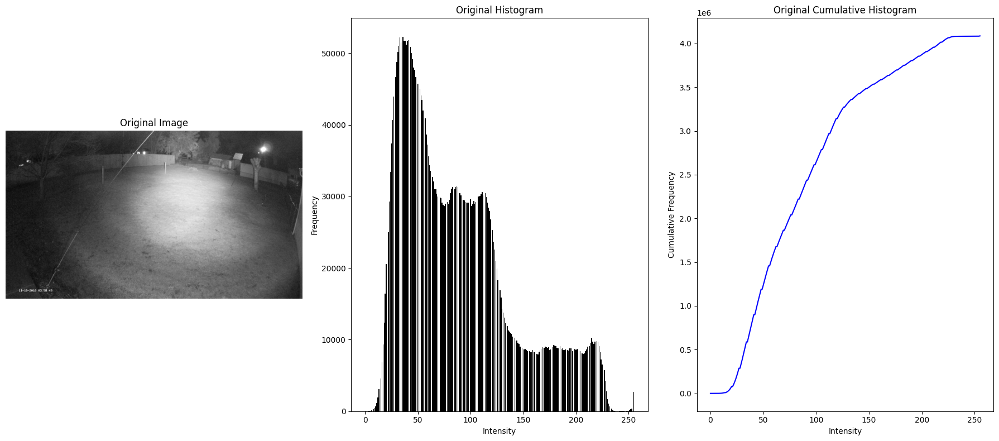

Intensities covering 5% of the image: 26 - 202
Intensities covering 10% of the image: 31 - 174
Intensities covering 15% of the image: 36 - 146
Intenities with maximum slope-like score: 15 - 225


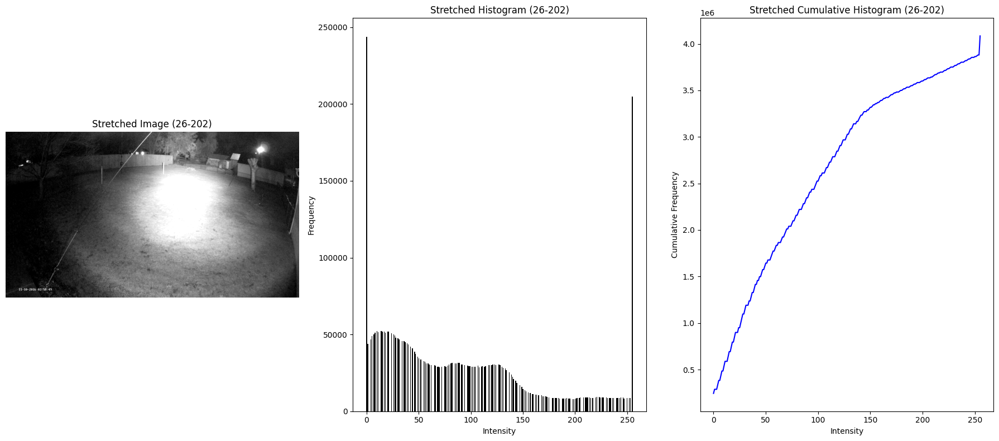

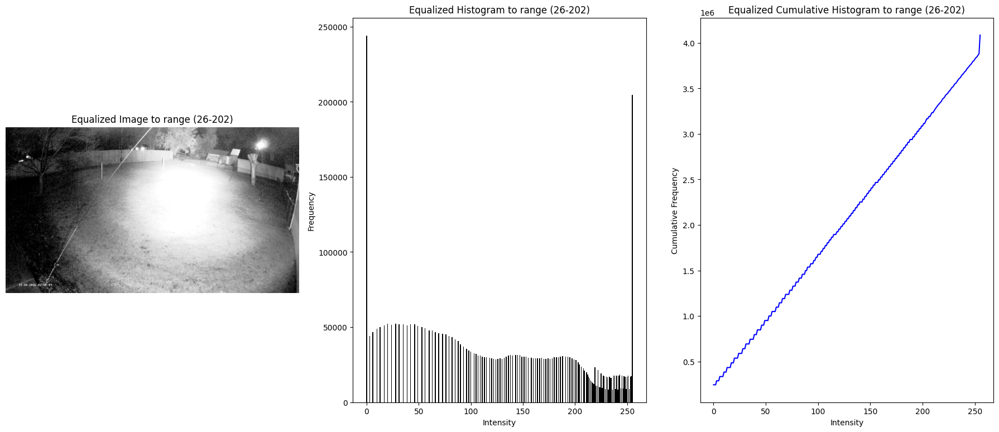

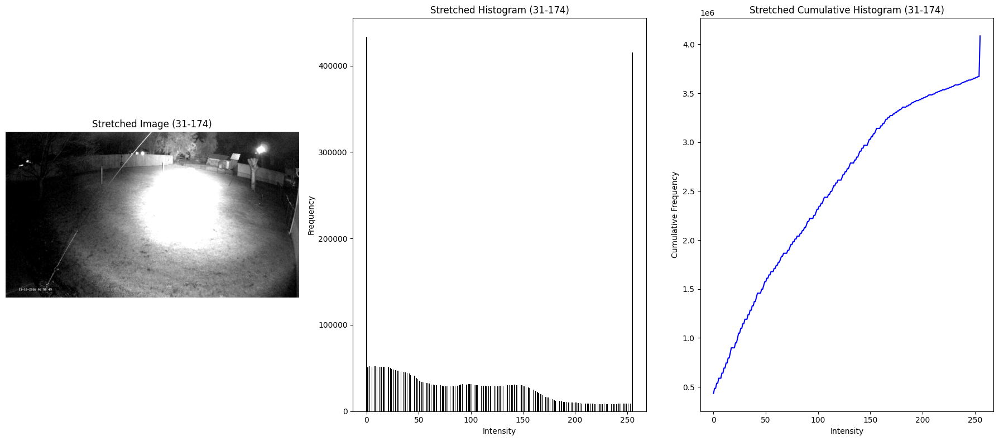

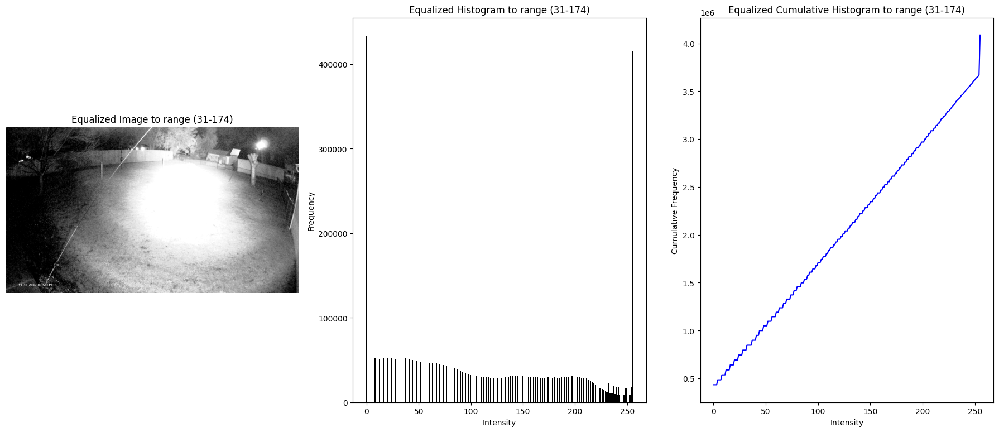

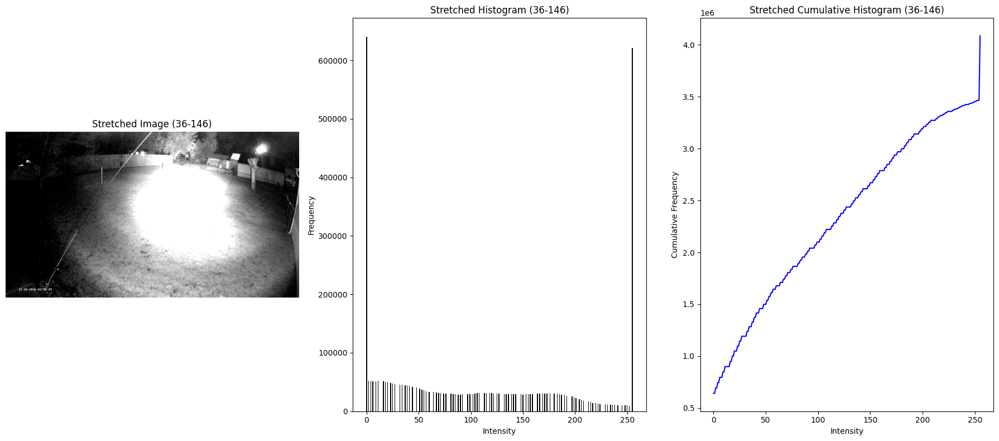

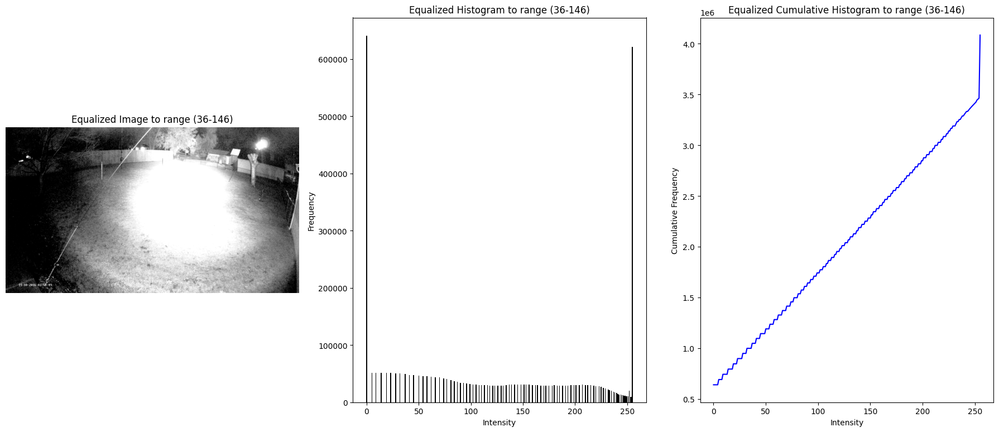

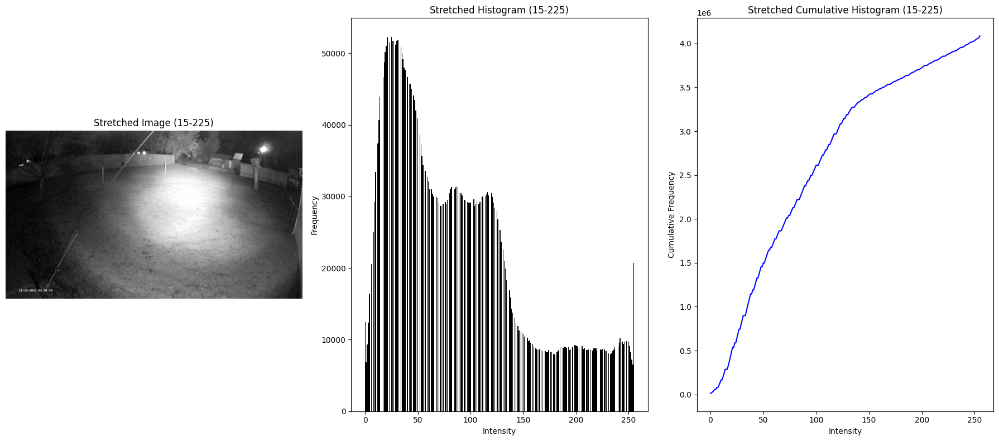

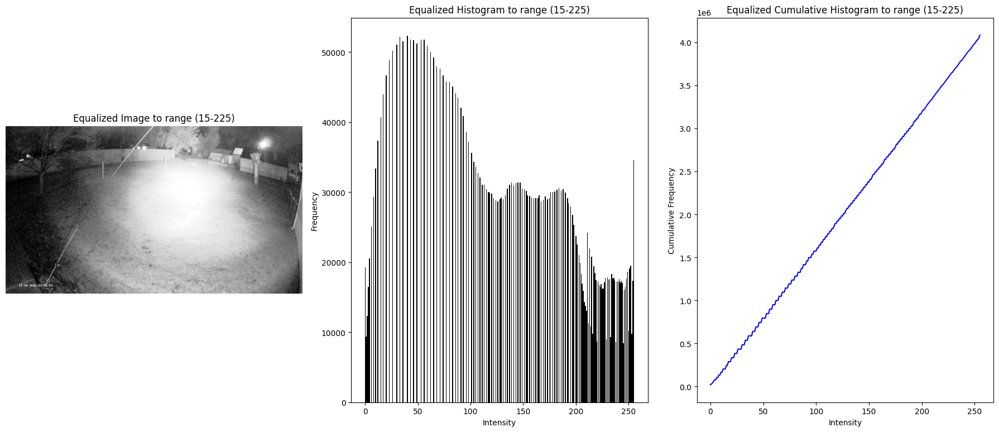

In [5]:
test(img_path='./test1.png', percentages=percentages, a=a, b=b)

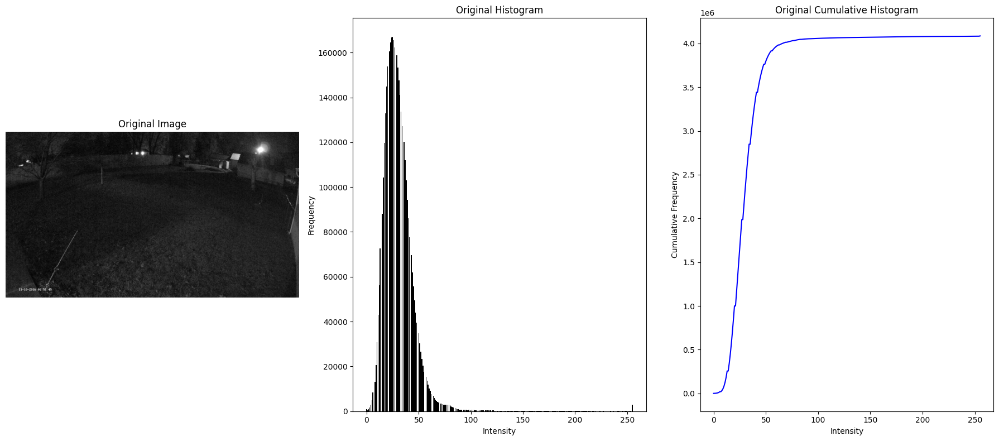

Intensities covering 5% of the image: 13 - 54
Intensities covering 10% of the image: 16 - 46
Intensities covering 15% of the image: 18 - 43
Intenities with maximum slope-like score: 9 - 53


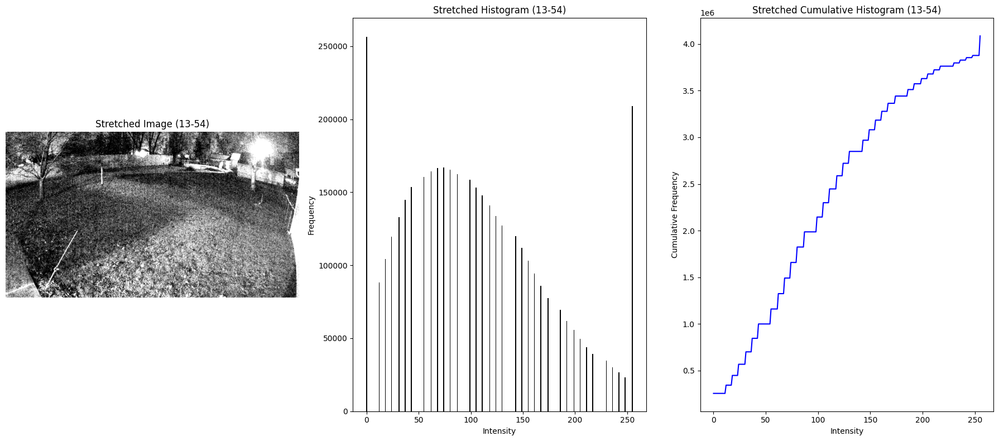

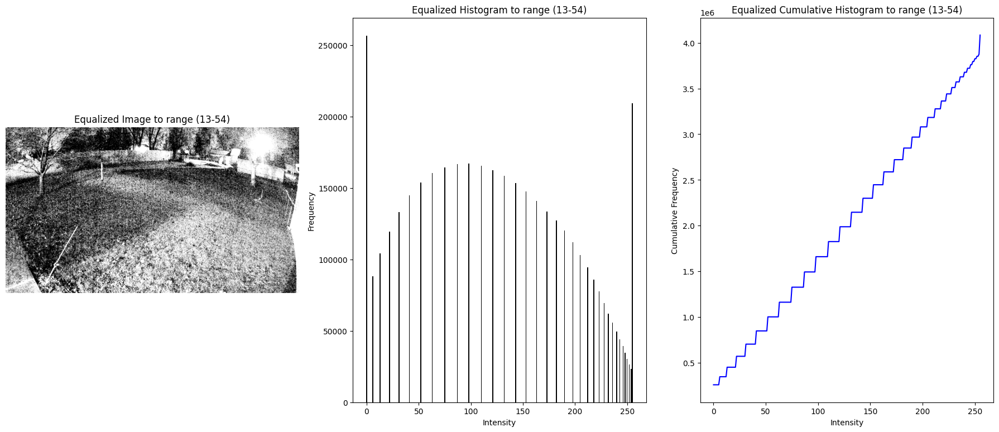

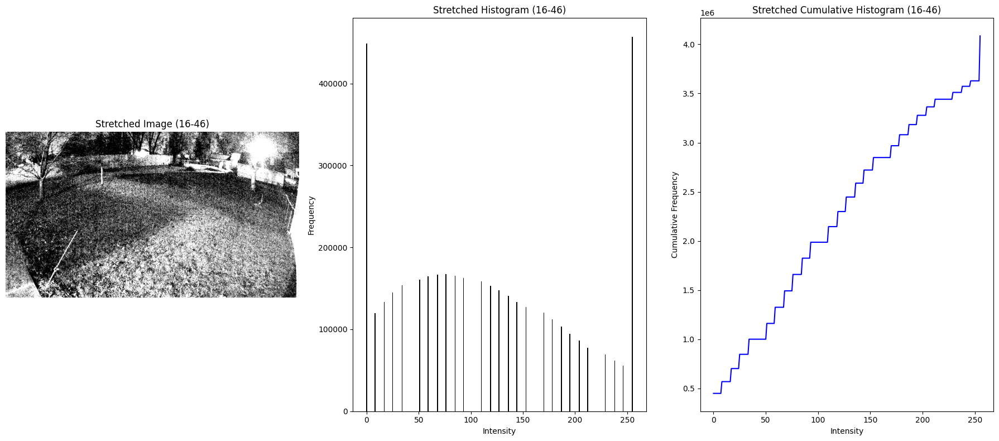

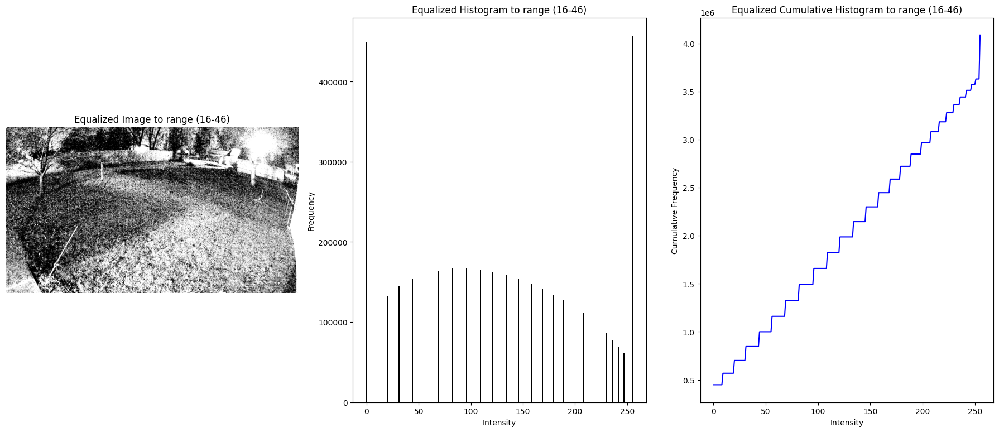

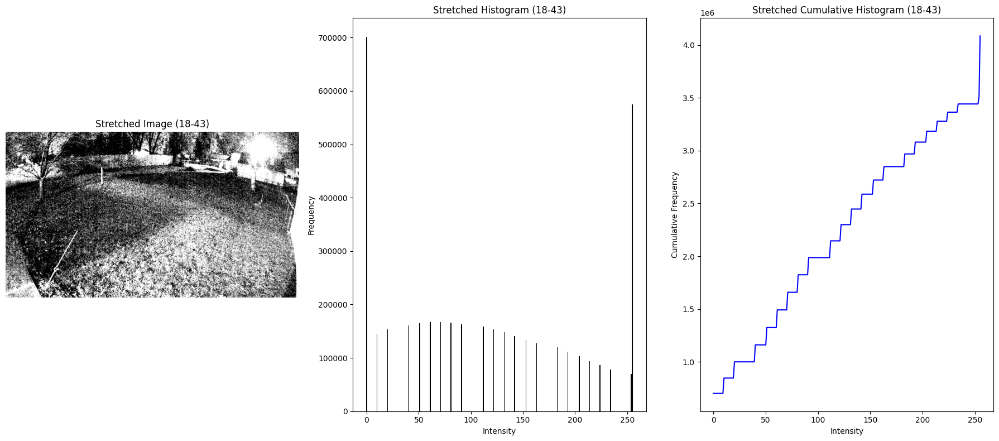

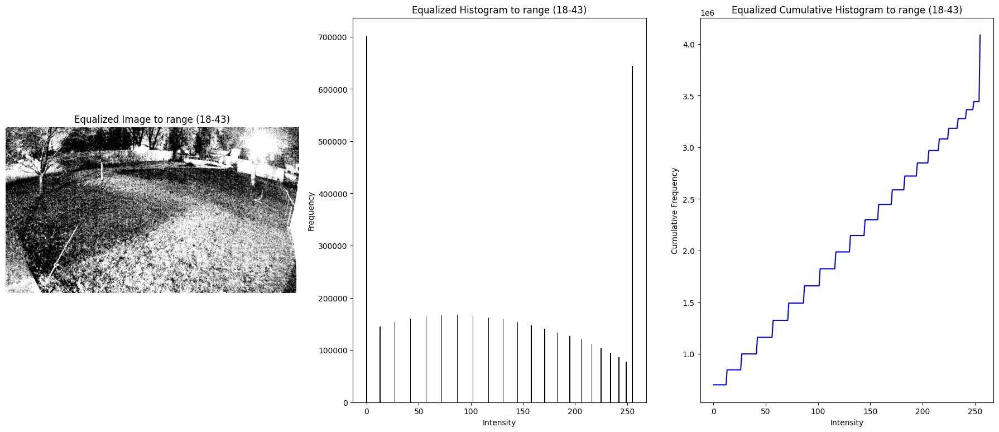

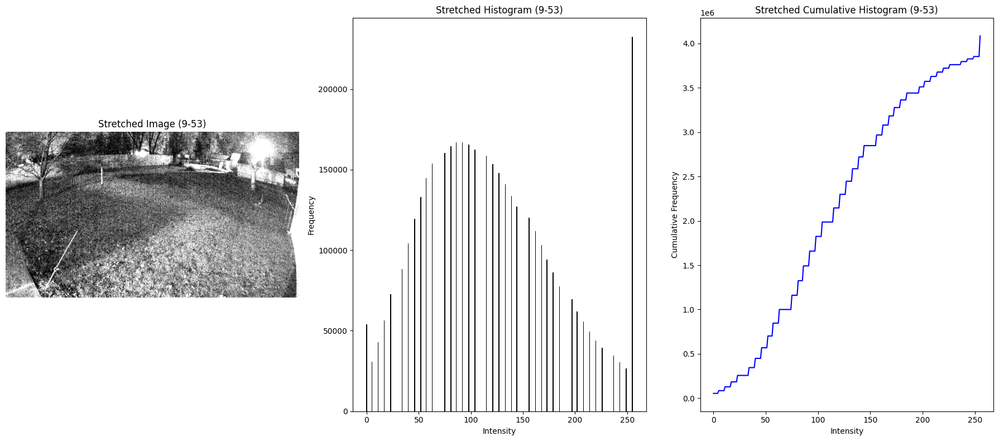

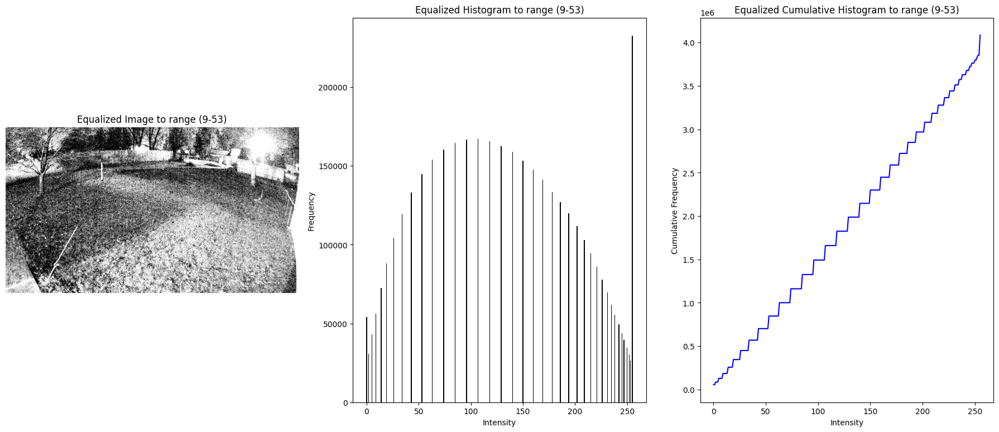

In [6]:
test(img_path='./test2.png', percentages=percentages, a=a, b=b)

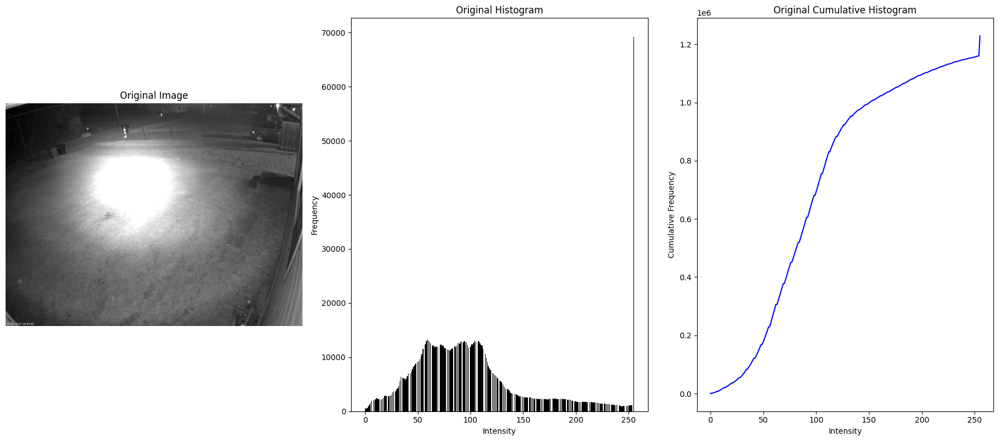

Intensities covering 5% of the image: 30 - 255
Intensities covering 10% of the image: 43 - 207
Intensities covering 15% of the image: 51 - 173
Intenities with maximum slope-like score: 7 - 255


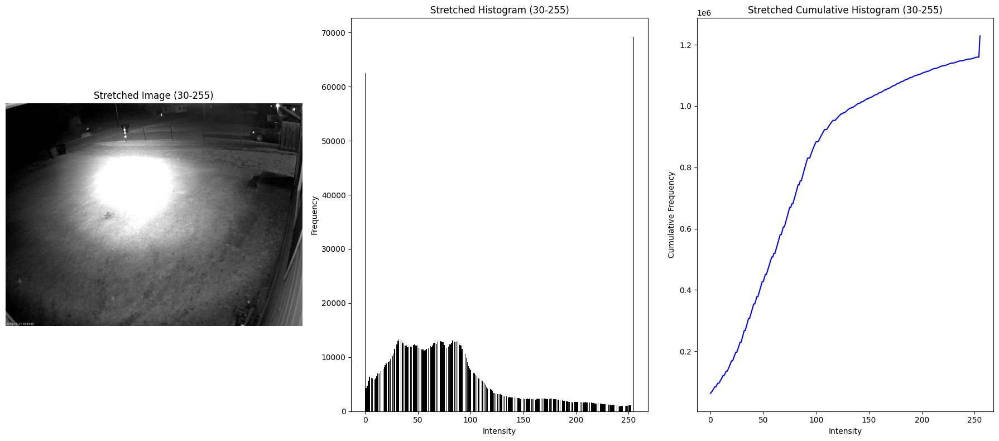

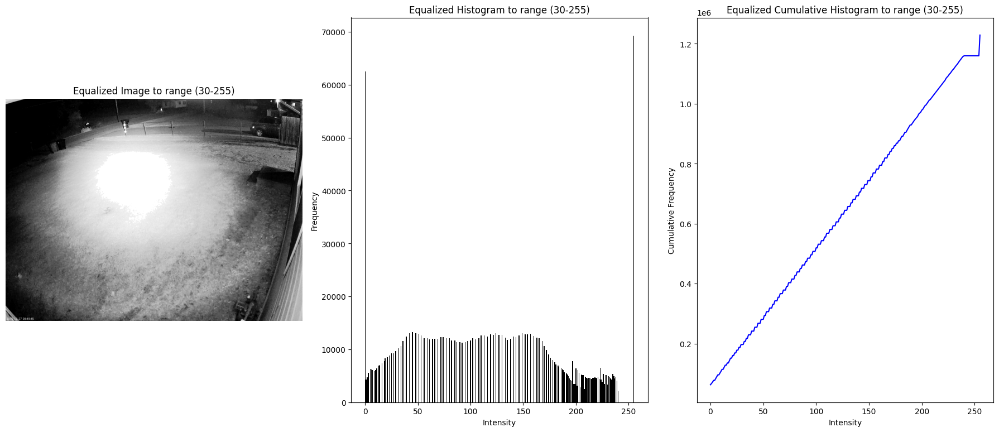

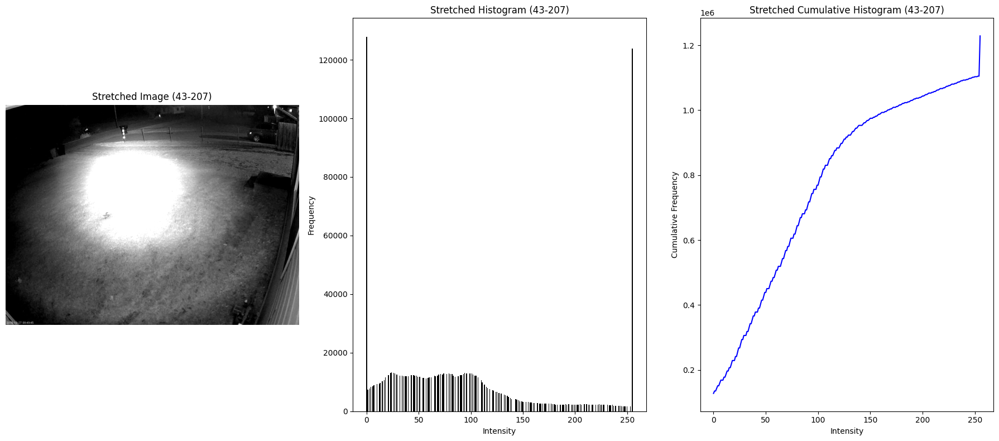

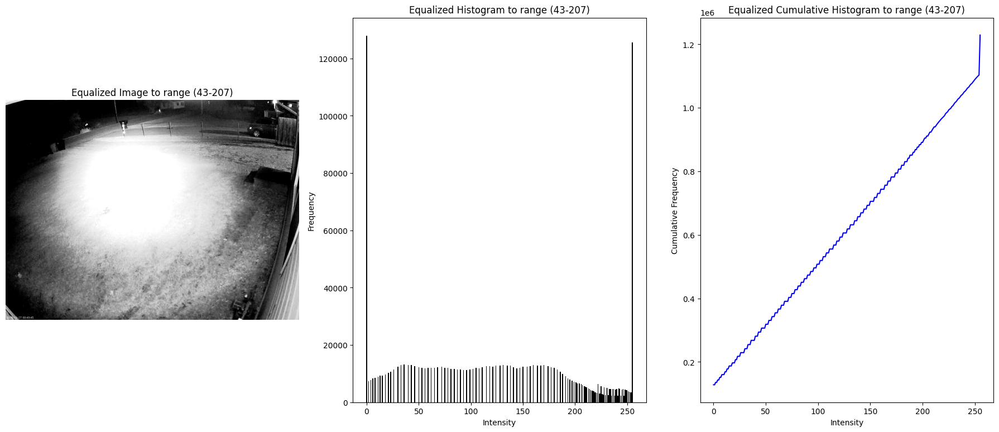

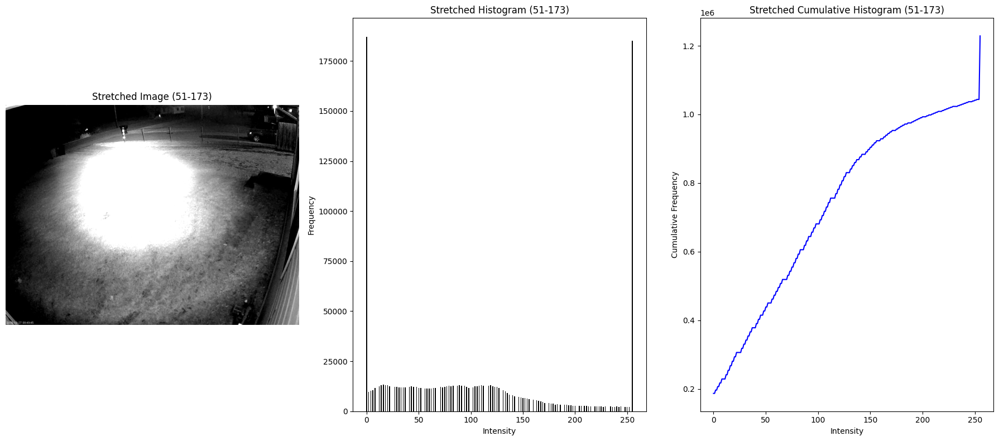

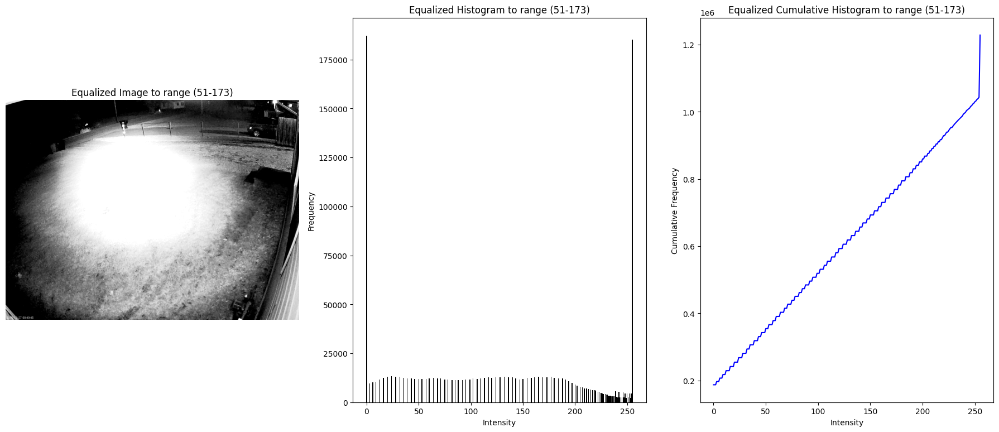

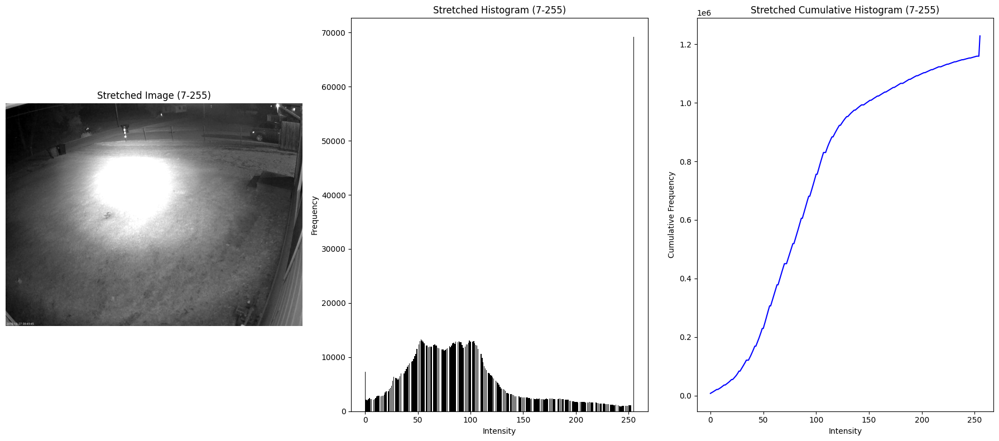

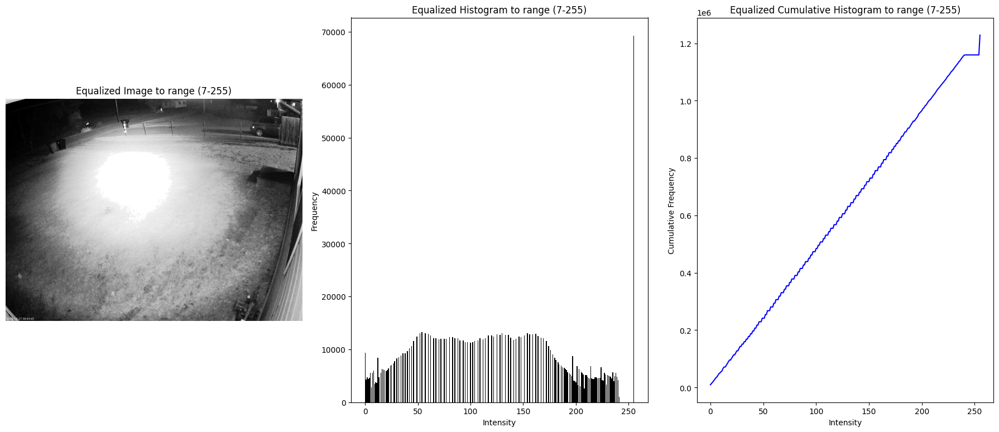

In [7]:
test(img_path='./test3.png', percentages=percentages, a=a, b=b)

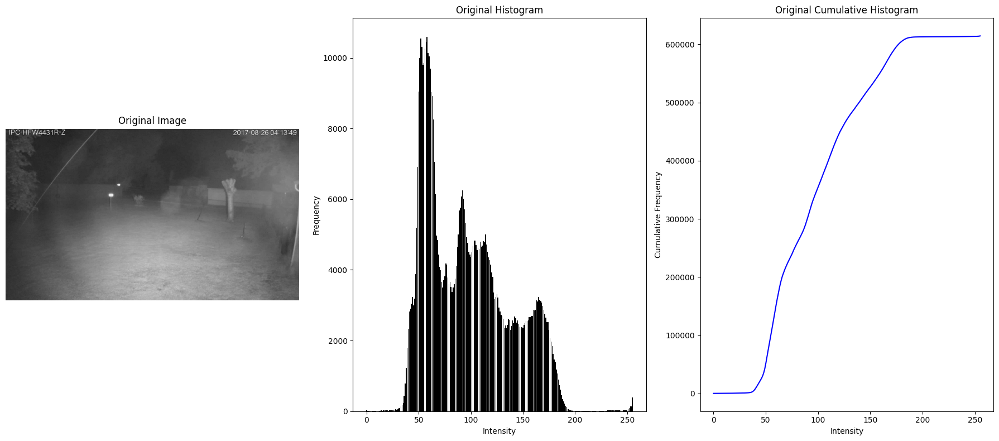

Intensities covering 5% of the image: 48 - 171
Intensities covering 10% of the image: 52 - 160
Intensities covering 15% of the image: 55 - 149
Intenities with maximum slope-like score: 37 - 183


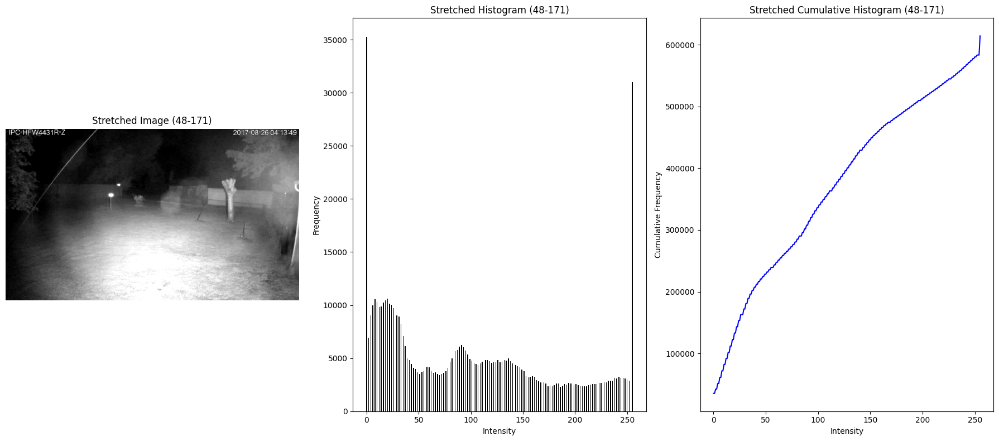

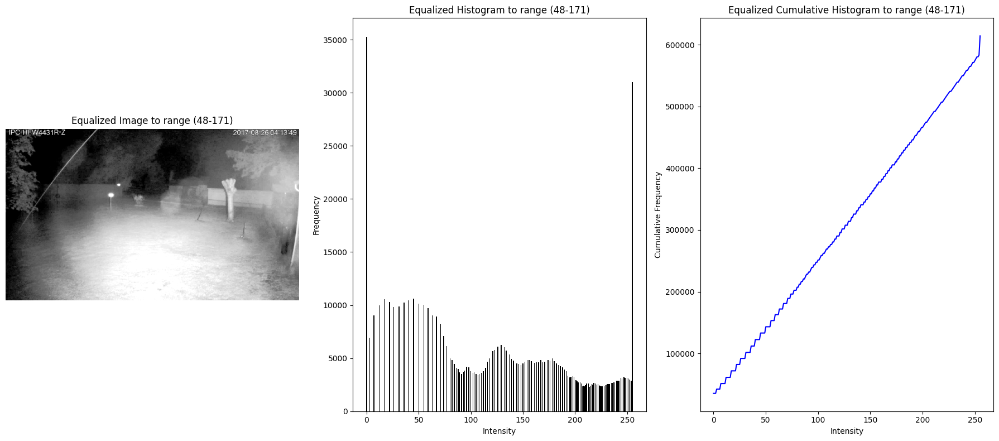

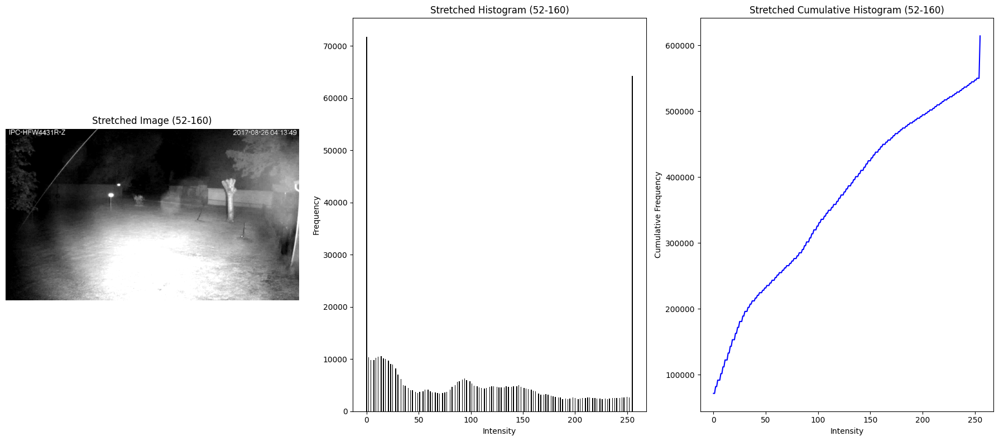

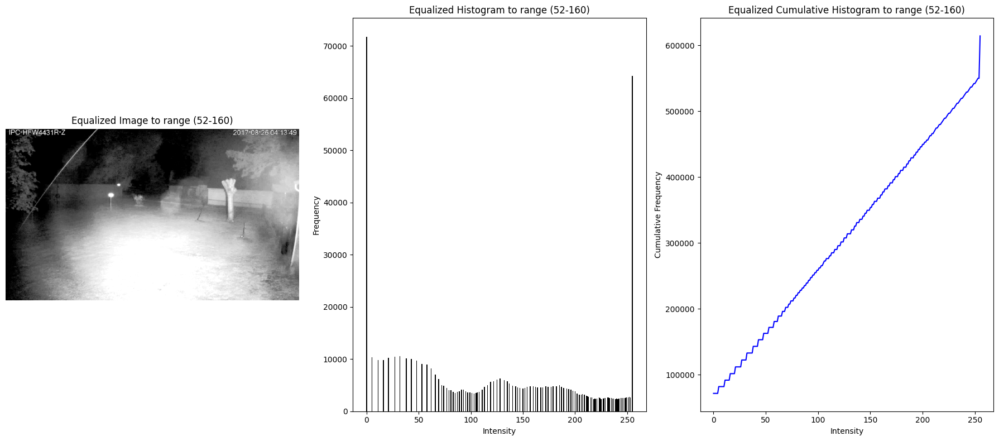

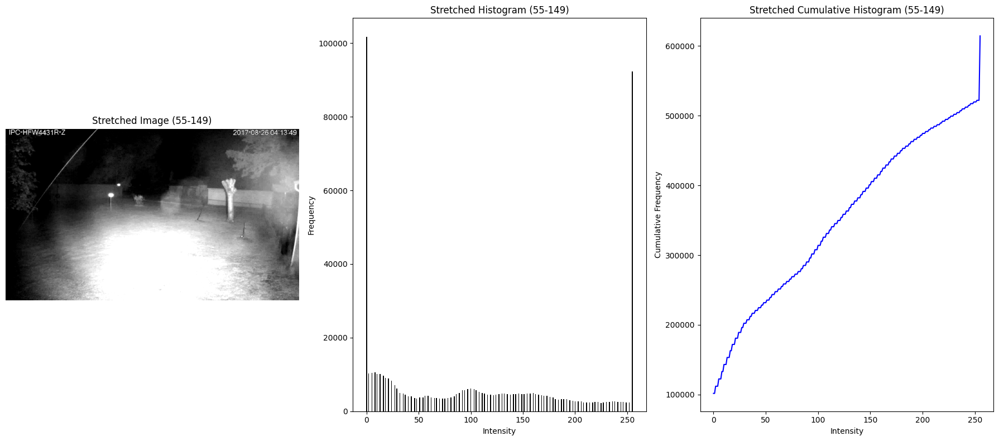

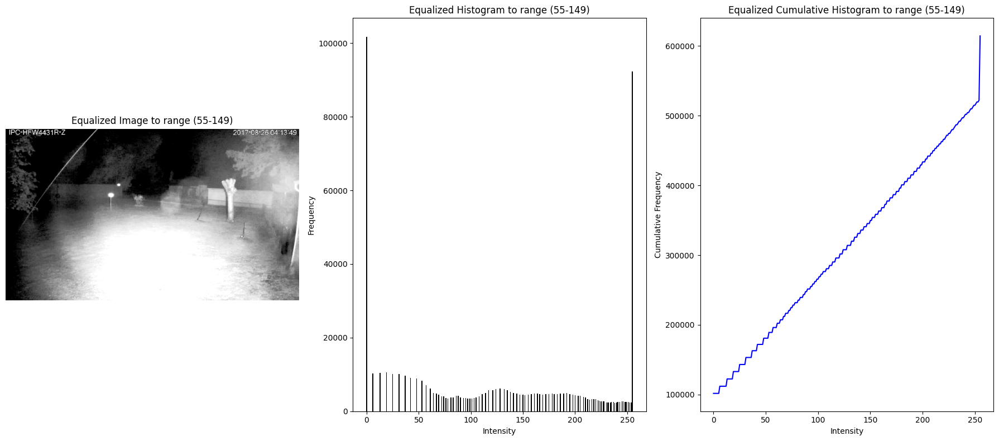

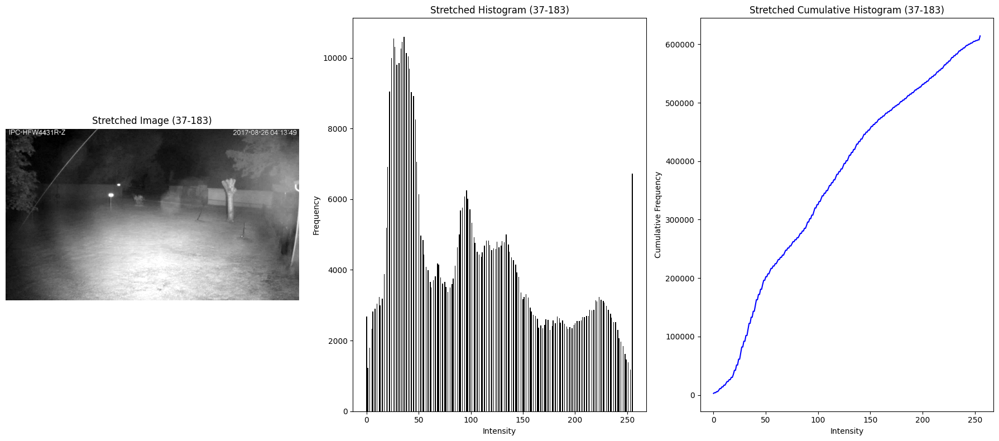

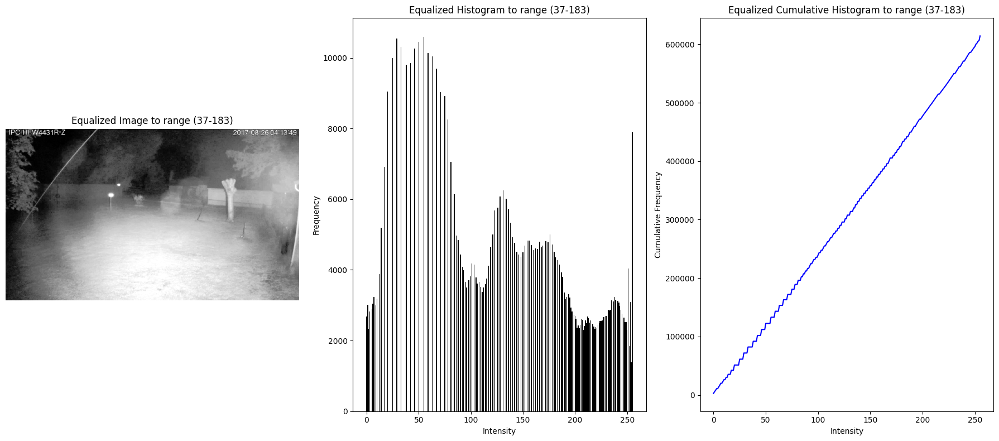

In [8]:
test(img_path='./test4.jpg',  percentages=percentages, a=a, b=b)

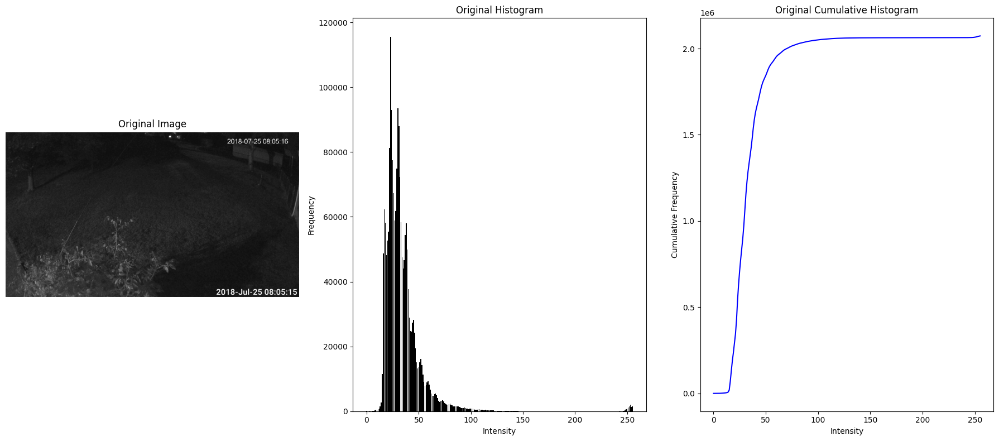

Intensities covering 5% of the image: 17 - 64
Intensities covering 10% of the image: 19 - 52
Intensities covering 15% of the image: 21 - 46
Intenities with maximum slope-like score: 15 - 53


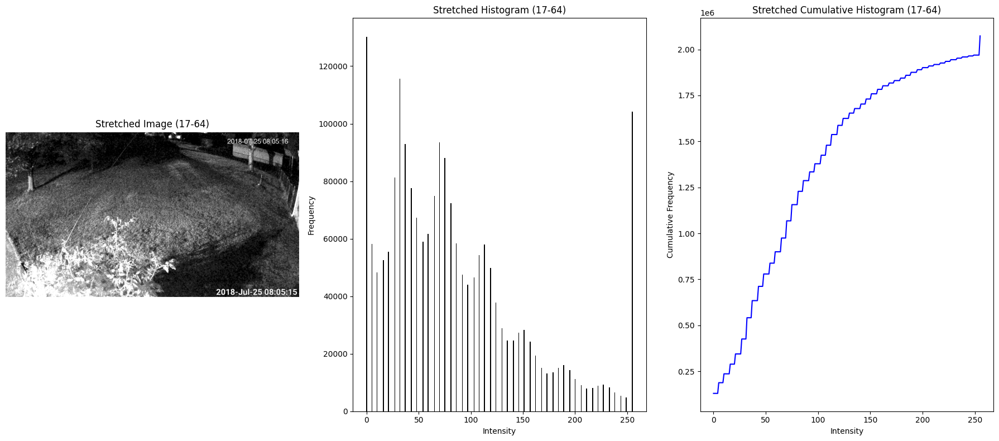

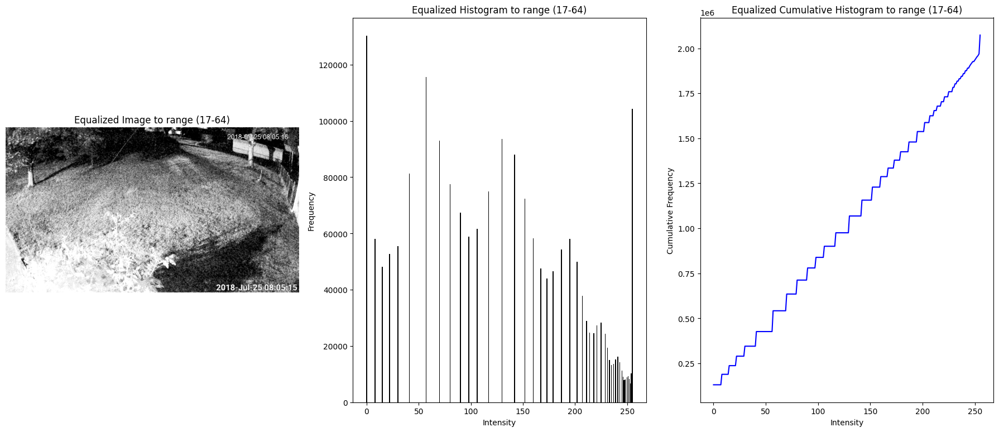

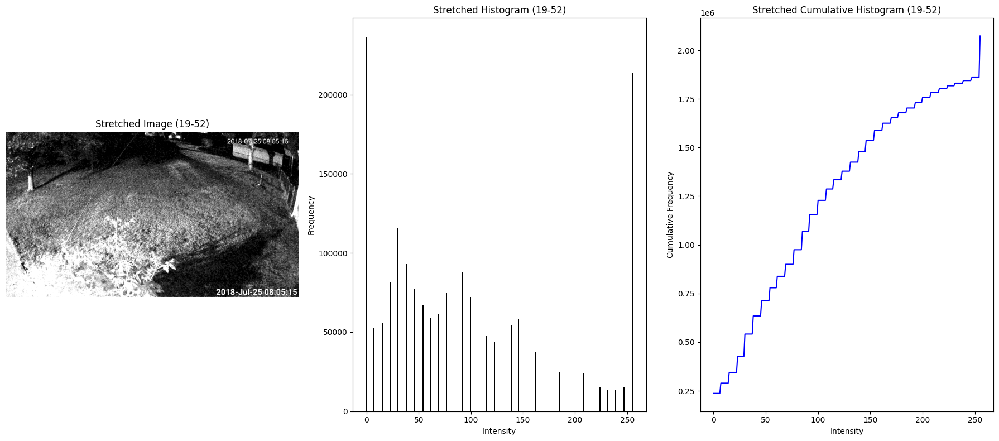

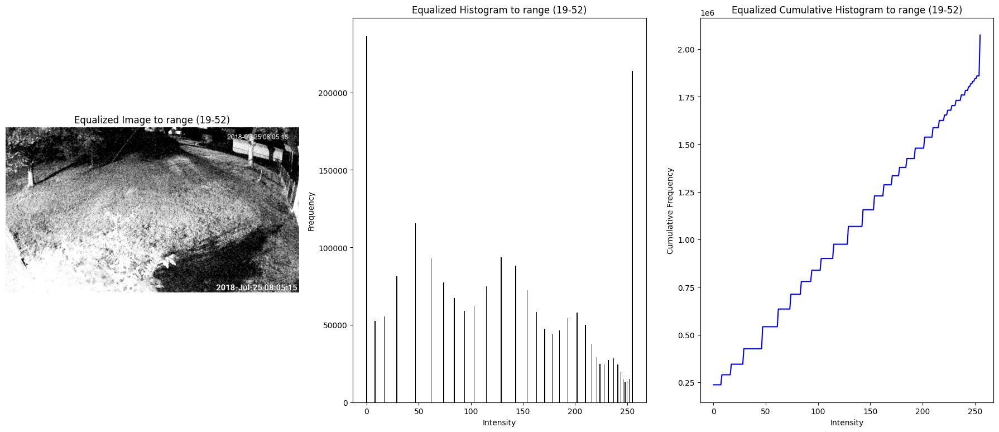

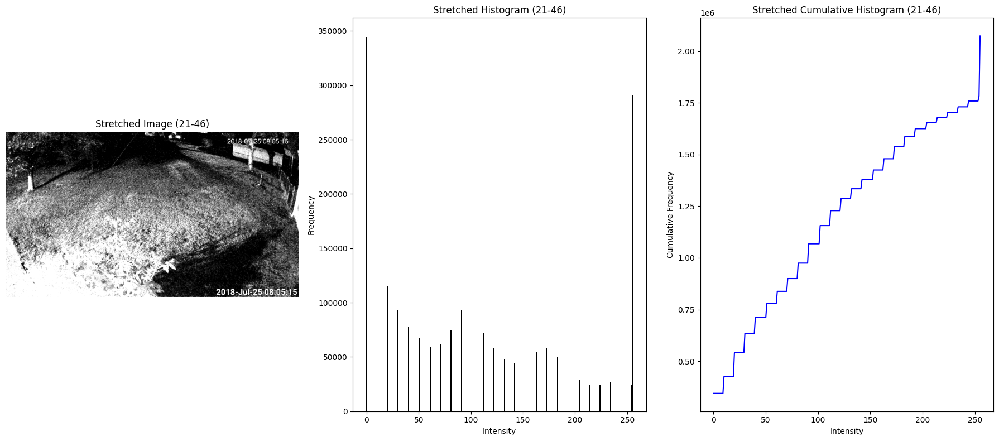

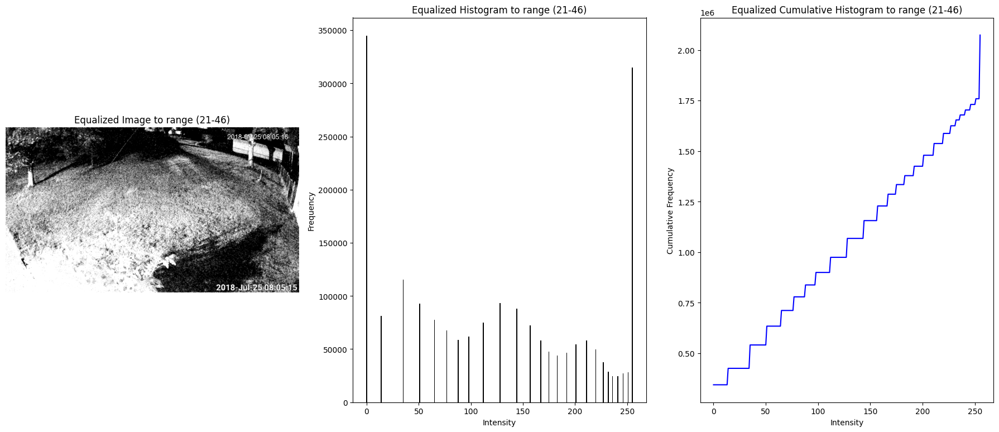

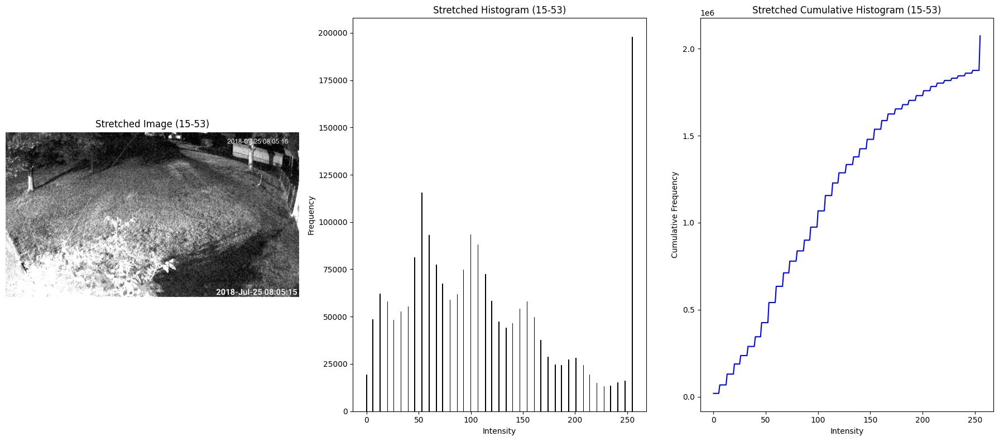

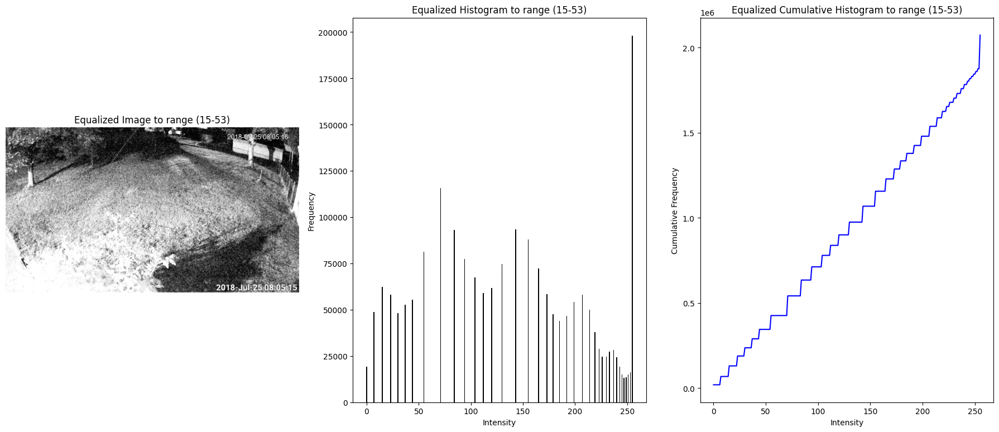

In [9]:
test(img_path='./test5.jpg', percentages=percentages, a=a, b=b)

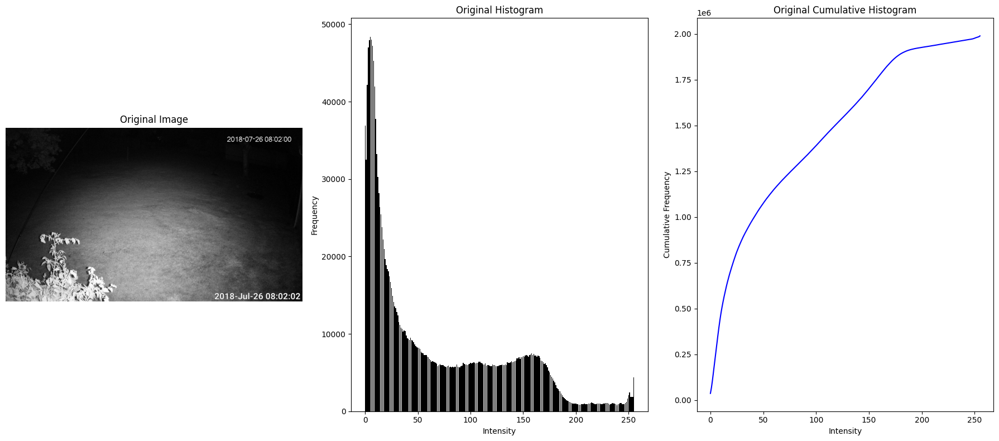

Intensities covering 5% of the image: 2 - 180
Intensities covering 10% of the image: 4 - 163
Intensities covering 15% of the image: 6 - 149
Intenities with maximum slope-like score: 0 - 185


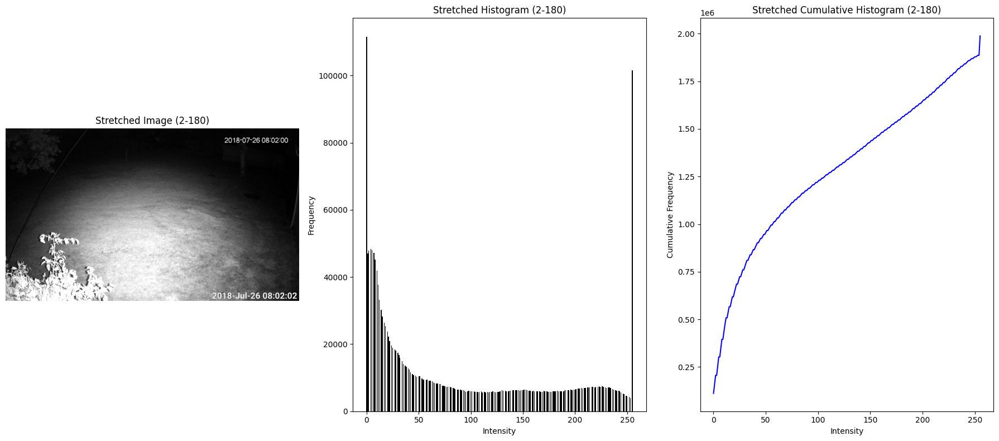

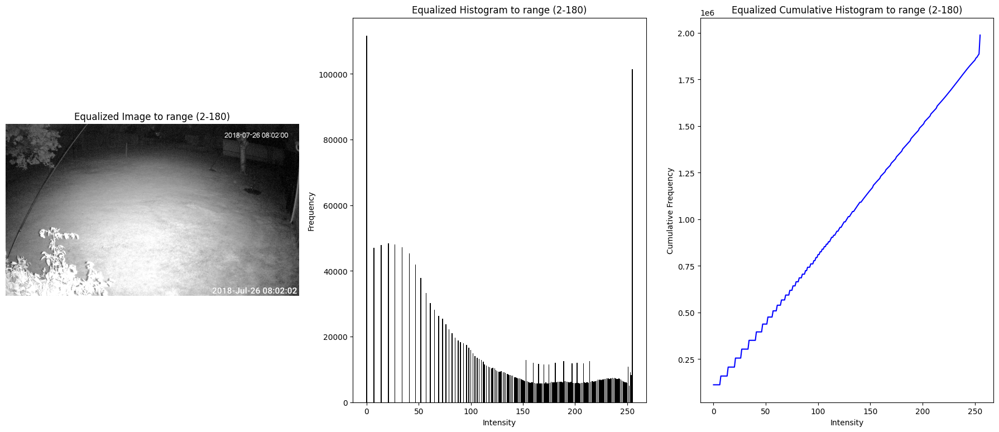

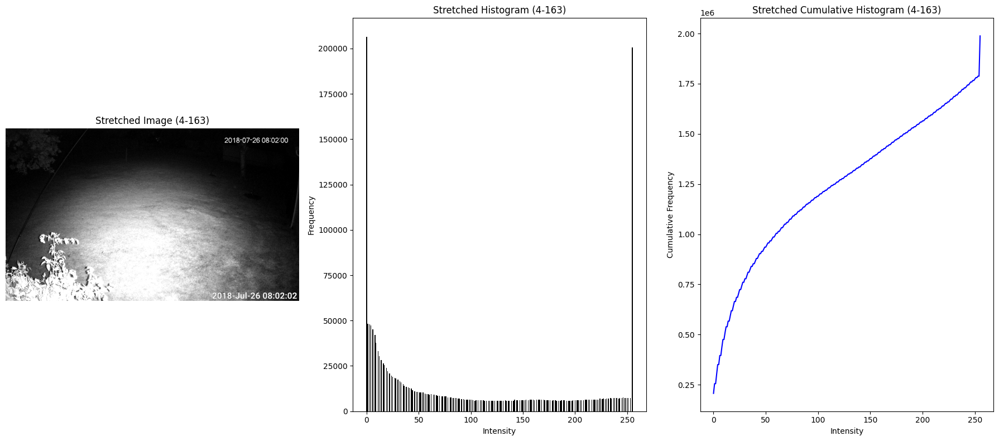

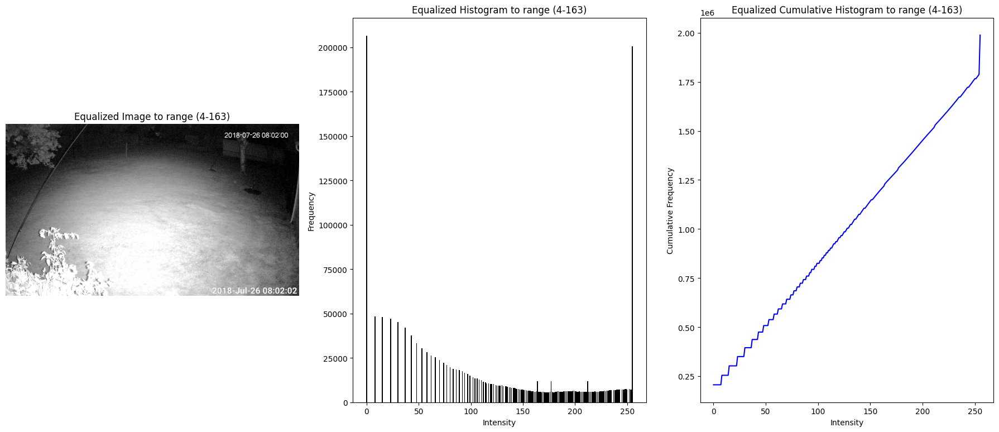

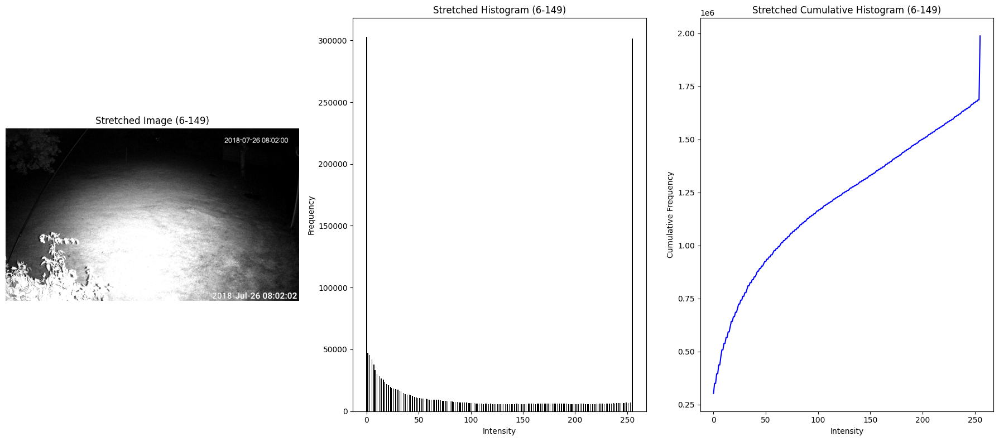

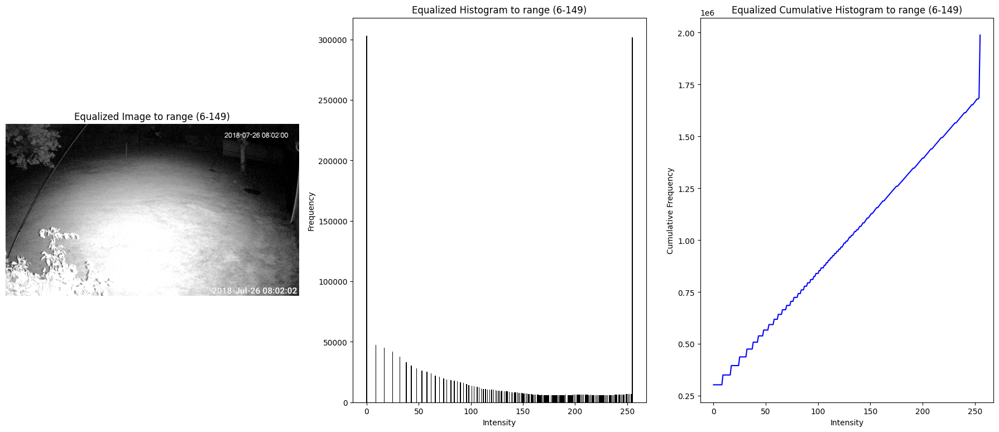

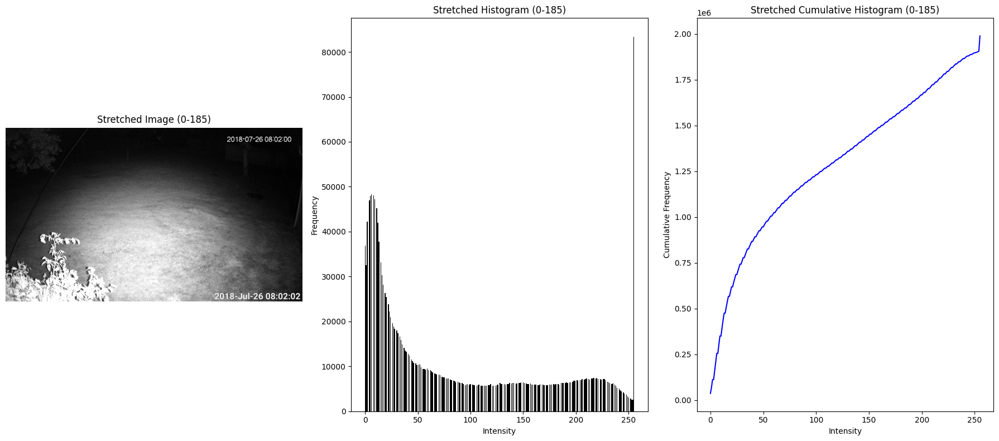

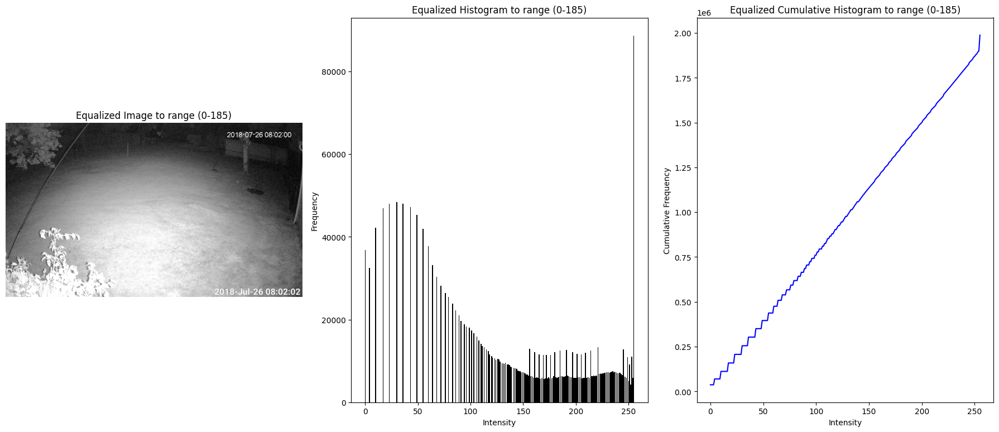

In [10]:
test(img_path='./test6.jpg', percentages=percentages, a=a, b=b)

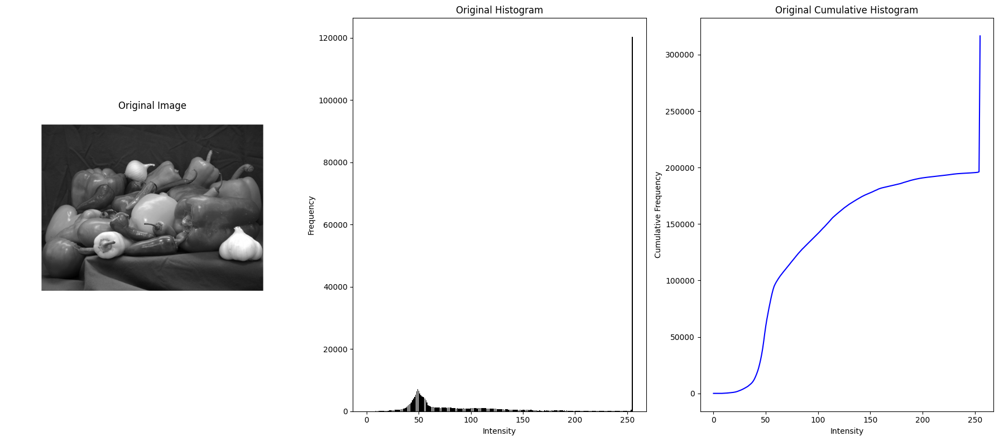

Intensities covering 5% of the image: 41 - 255
Intensities covering 10% of the image: 46 - 255
Intensities covering 15% of the image: 49 - 255
Intenities with maximum slope-like score: 254 - 255


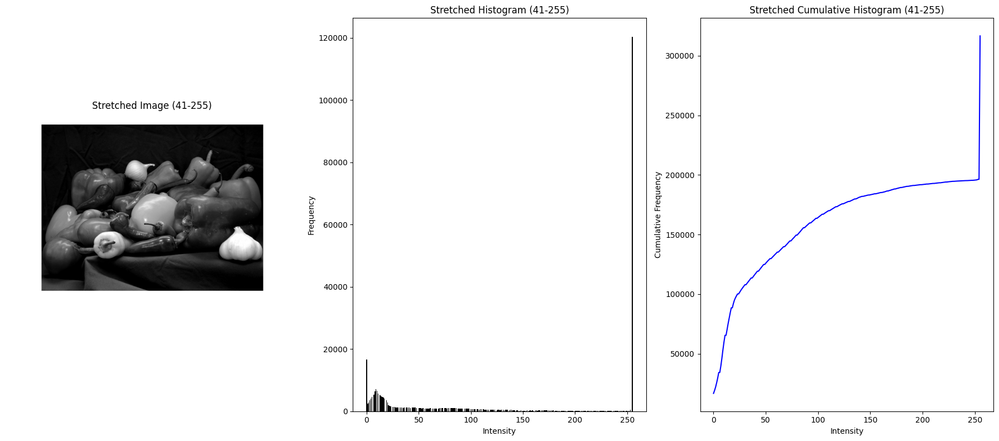

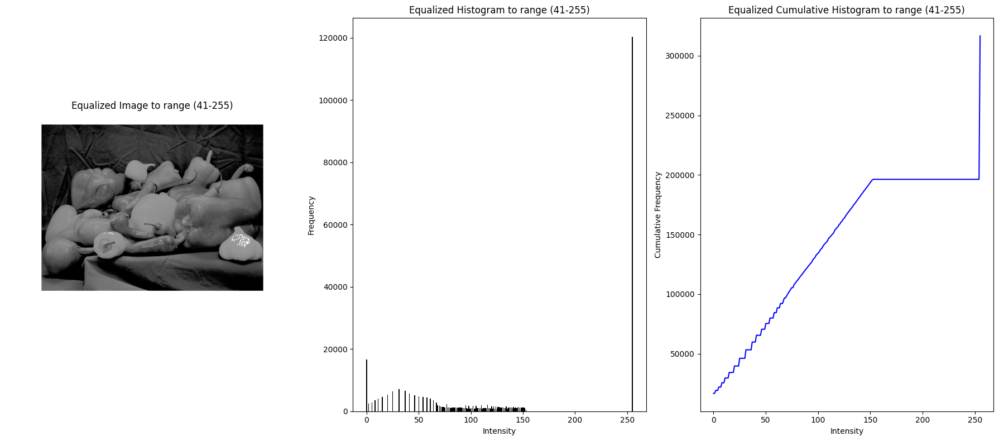

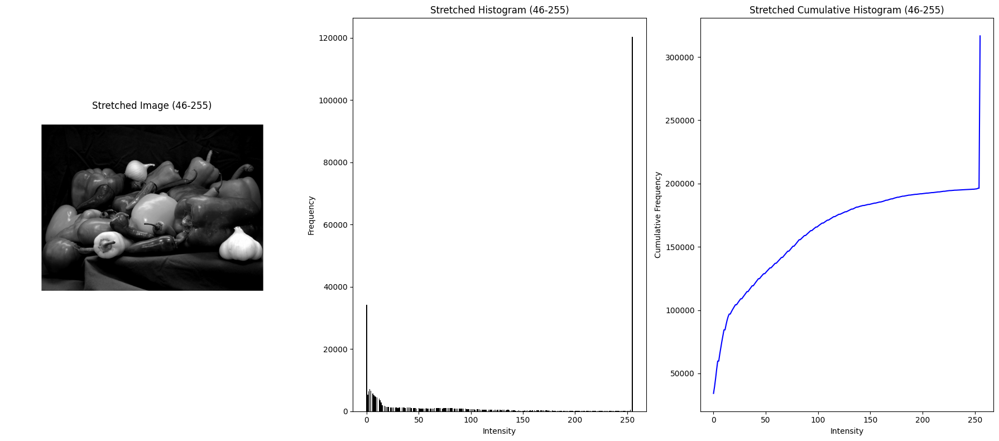

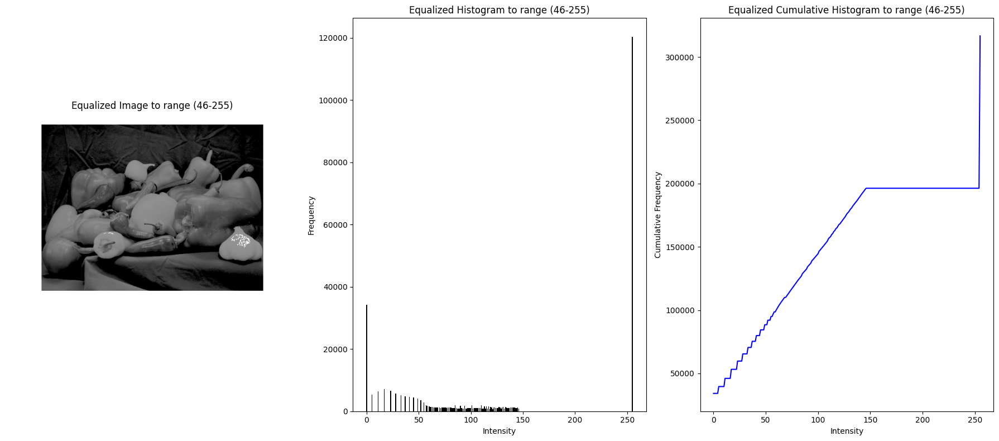

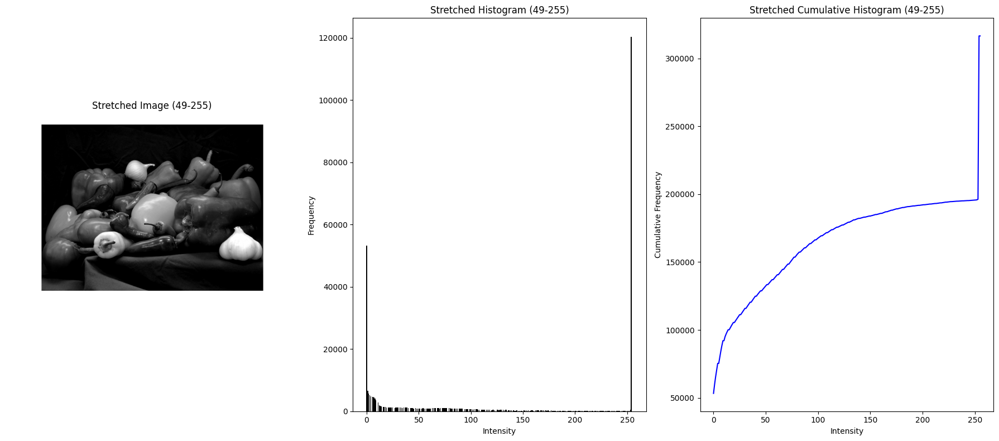

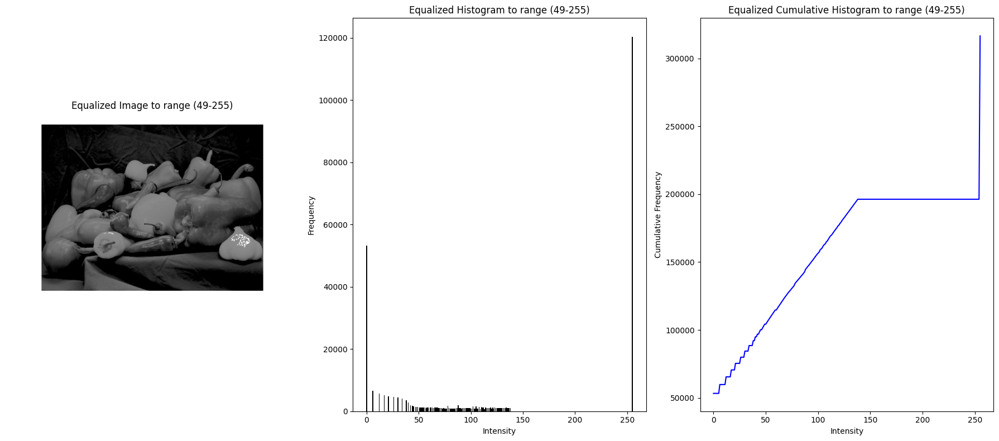

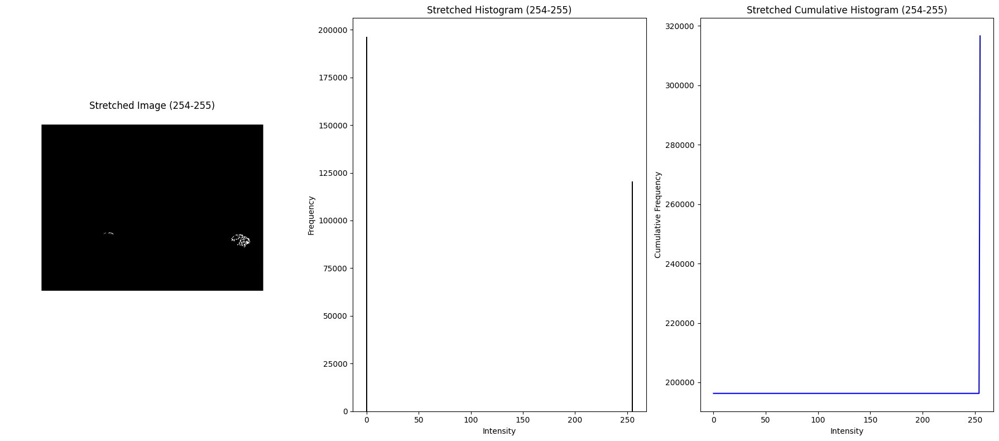

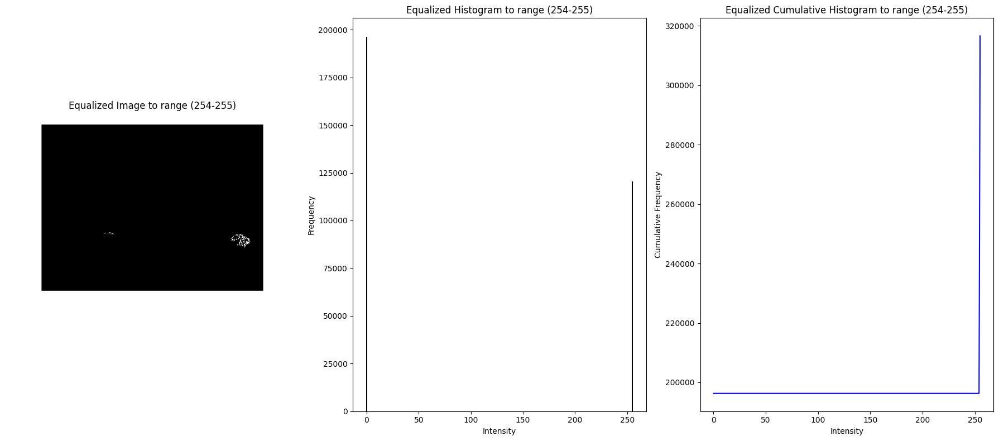

In [11]:
test(img_path='./test7.png', percentages=percentages, a=a, b=b)